# Importing Needed Libraries

In [ ]:
# Common imports
import os
import numpy as np
import tensorflow as tf
from tensorflow import keras
from typing import Tuple, List

# Data Imports
import pandas as pd
from tqdm import tqdm
from glob import glob
from tensorflow import data as tfd
from tensorflow import image as tfi

# Data Visualization
import plotly.express as px
import matplotlib.pyplot as plt
from IPython.display import clear_output as cls

# Model Architecture
from tensorflow.keras import Sequential
from tensorflow.keras.applications import ResNet50V2
from tensorflow.keras.applications import ResNet152V2
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications import Xception
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import GlobalAveragePooling2D, Dropout, Dense

# Model Training
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ModelCheckpoint
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report

# Import necessary libraries
import os
import plotly.express as px




In [ ]:
# Model Hypertunning
!pip install -q keras_tuner
cls()
import keras_tuner as kt

# Prepare dataset

In [ ]:
# Constants
IMAGE_SIZE = 160 # size of the input image
BATCH_SIZE = 32 # number of samples per gradient update
EPOCHS = 50 # number of epochs to train the model

# Hyperparameters
LEARNING_RATE = 1e-3 # learning rate for the optimizer

# # Specify the directory paths for the data
# root_dir = "/kaggle/input/fruits-classification/Fruits Classification/"
# train_dir = f"{root_dir}train/" # path to the directory containing training data
# # train_dir = f"train/" # path to the directory containing training data
# valid_dir = f"{root_dir}valid/" # path to the directory containing validation data
# # valid_dir = f"valid/" # path to the directory containing validation data
# test_dir = f"{root_dir}test/" # path to the directory containing test data
# # test_dir = f"test/" # path to the directory containing test data

# Model training
LOSS = 'sparse_categorical_crossentropy'
METRICS = ['accuracy']

# Random Seed
random_seed = 42 # set random seed for reproducibility
tf.random.set_seed(random_seed) # set random seed for TensorFlow
np.random.seed(random_seed) # set random seed for NumPy

In [ ]:
# Collect the class names
class_names = sorted(os.listdir('/content/drive/MyDrive/Deep/Fruits Recognition/Fruits Classification/train'))
n_classes = len(class_names)

# Show
print(f"Total number of classes: {n_classes}")
print(f"Classes: {class_names}")

Total number of classes: 5
Classes: ['Apple', 'Banana', 'Grape', 'Mango', 'Strawberry']


In [ ]:
def load_image(image_path: str) -> tf.Tensor:

    # Check if image path exists
    assert os.path.exists(image_path), f'Invalid image path: {image_path}'

    # Read the image file
    image = tf.io.read_file(image_path)

    # Load the image
    try:
        image = tfi.decode_jpeg(image, channels=3)
    except:
        image = tfi.decode_png(image, channels=3)

    # Change the image data type
    image = tfi.convert_image_dtype(image, tf.float32)

    # Resize the Image
    image = tfi.resize(image, (IMAGE_SIZE, IMAGE_SIZE))

    # Convert image data type to tf.float32
    image = tf.cast(image, tf.float32)

    return image

In [ ]:
def load_dataset(root_path: str, class_names: list, trim: int=None) -> Tuple[np.ndarray, np.ndarray]:

    if trim:
        # Trim the size of the data
        n_samples = len(class_names) * trim
    else:
        # Collect total number of data samples
        n_samples = sum([len(os.listdir(os.path.join(root_path, name))) for name in class_names])

    # Create arrays to store images and labels
    images = np.empty(shape=(n_samples, IMAGE_SIZE, IMAGE_SIZE, 3), dtype=np.float32)
    labels = np.empty(shape=(n_samples, 1), dtype=np.int32)

    # Loop over all the image file paths, load and store the images with respective labels
    n_image = 0
    for class_name in tqdm(class_names, desc="Loading"):
        class_path = os.path.join(root_path, class_name)
        image_paths = list(glob(os.path.join(class_path, "*")))[:trim]
        for file_path in image_paths:
            # Load the image
            image = load_image(file_path)

            # Assign label
            label = class_names.index(class_name)

            # Store the image and the respective label
            images[n_image] = image
            labels[n_image] = label

            # Increment the number of images processed
            n_image += 1

    # Shuffle the data
    indices = np.random.permutation(n_samples)
    images = images[indices]
    labels = labels[indices]


    return images, labels

**Loading Datasets for Training, Validation, and Testing**

In [ ]:
# Load the training dataset
X_train, y_train = load_dataset(root_path = '/content/drive/MyDrive/Deep/Fruits Recognition/Fruits Classification/train', class_names = class_names, trim=1000)  # 1000 images per class

# # Load the validation dataset
X_valid, y_valid = load_dataset(root_path = '/content/drive/MyDrive/Deep/Fruits Recognition/Fruits Classification/valid', class_names = class_names)

# Load the testing dataset
X_test, y_test = load_dataset(root_path = '/content/drive/MyDrive/Deep/Fruits Recognition/Fruits Classification/test', class_names = class_names)

Loading: 100%|██████████| 5/5 [01:21<00:00, 16.31s/it]


# Explore and Visualize Data to Gain Insights

In [ ]:

# Define the train path
train_path = '/content/drive/MyDrive/Deep/Fruits Recognition/Fruits Classification/train/'

# Check class names
class_names = os.listdir(train_path)
print(f"Class names: {class_names}")

# Calculate class distribution
class_dis = [len(os.listdir(train_path + name)) for name in class_names]

# Visualize using interactive pie chart
pie_chart = px.pie(values=class_dis, names=class_names, color=class_names)
pie_chart.update_layout({'title': {'text': "Class Distribution"}})
pie_chart.show()

# Visualize using interactive bar chart
bar_chart = px.bar(x=class_names, y=class_dis, color=class_names)
bar_chart.show()


Class names: ['Grape', 'Mango', 'Strawberry', 'Banana', 'Apple']


In [ ]:
def show_images(images: np.ndarray, labels: np.ndarray, n_rows: int=1, n_cols: int=5, figsize: tuple=(25, 8), model: tf.keras.Model=None) -> None:
    """
    Plots a grid of random images and their corresponding labels, with an optional prediction from a given model.

    Args:
        images (np.ndarray): Array of images to plot.
        labels (np.ndarray): Array of labels corresponding to the images.
        n_rows (int): Number of rows in the plot grid. Default is 1.
        n_cols (int): Number of columns in the plot grid. Default is 5.
        figsize (tuple): A tuple specifying the size of the figure. Default is (25, 8).
        model (tf.keras.Model): A Keras model object used to make predictions on the images. Default is None.

    Returns:
        None
    """

    # Loop over each row of the plot
    for row in range(n_rows):
        # Create a new figure for each row
        plt.figure(figsize=figsize)

        # Generate a random index for each column in the row
        rand_indices = np.random.choice(len(images), size=n_cols, replace=False)

        # Loop over each column of the plot
        for col, index in enumerate(rand_indices):
            # Get the image and label at the random index
            image = images[index]
            label = class_names[int(labels[index])]

            # If a model is provided, make a prediction on the image
            if model:
                prediction = model.predict(np.expand_dims(tf.squeeze(image), axis=0), verbose=0)[0]
                conf = np.max(prediction, axis=-1)
                label += "\nPrediction: {} - {:.4}".format(class_names[np.argmax(prediction)], conf)

            # Plot the image and label
            plt.subplot(1, n_cols, col+1)
            plt.imshow(image)
            plt.title(label.title())
            plt.axis("off")

        # Show the row of images
        plt.show()

<ipython-input-25-8db3adcc0fb3>:29: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)



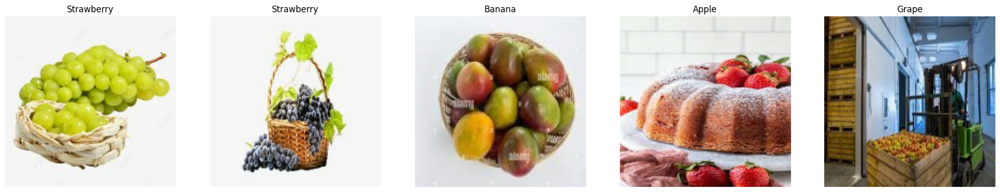

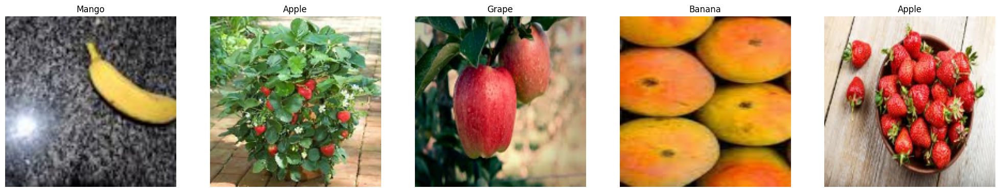

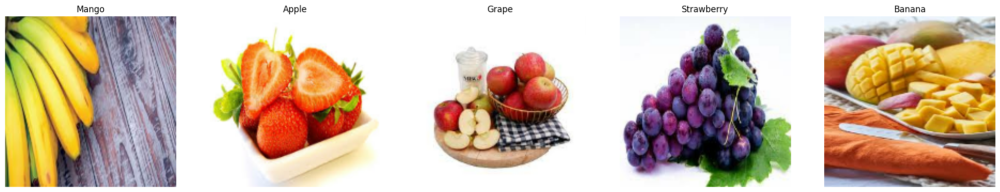

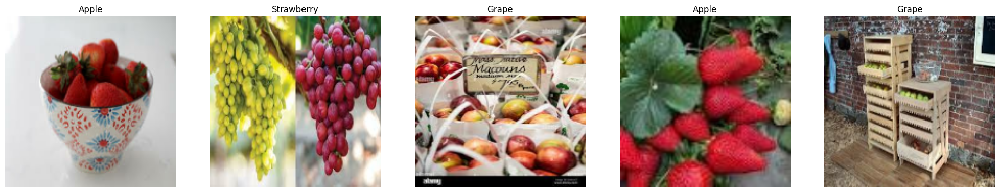

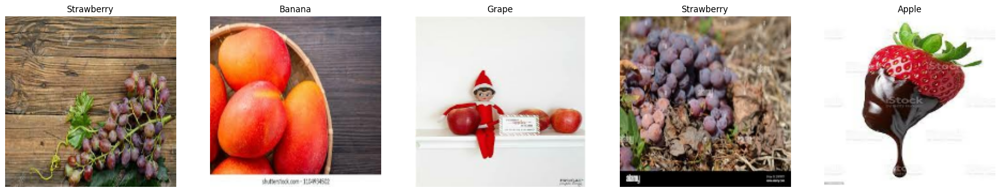

In [ ]:
# Visualize Training Dataset
show_images(images=X_train, labels=y_train, n_rows=5)

# Model Implementation

**Loading and Freezing Pre-trained Backbone Models**

In [ ]:
# Name all the backbones
backbone_names = [
    'InceptionV3',
    'Xception',
    'MobileNetV2'
]

# Load all the backbones
backbones = [
    InceptionV3(include_top=False, weights='imagenet', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
    Xception(include_top=False, weights='imagenet', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
    MobileNetV2(include_top=False, weights='imagenet', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
]

# Freeze the weights of all the backbones
for backbone in backbones:
    backbone.trainable = False

**Recording Learning Curves for Different Backbone Models**

In [ ]:
# Record the learing curve for all the backbones
HISTORIES = {}

# Loop over all the backbones
for name, backbone in zip(backbone_names, backbones):

    # Show
    print(f"Training: {name}\n")

    # Make a small model
    model = Sequential([
        backbone,
        GlobalAveragePooling2D(),
        Dropout(0.5),
        Dense(n_classes, activation='softmax')
    ])

    # Compile the model
    model.compile(
        loss=LOSS,
        optimizer=Adam(LEARNING_RATE),
        metrics=METRICS
    )

    # Train the model
    model_history = model.fit(
        X_train[:5000], y_train[:5000],
        validation_data=(X_valid, y_valid),
        epochs=10,
        batch_size=BATCH_SIZE
    )

    # Store the history
    HISTORIES[name] = model_history.history
    cls()

**Visualizing Model Training and Validation Curves**

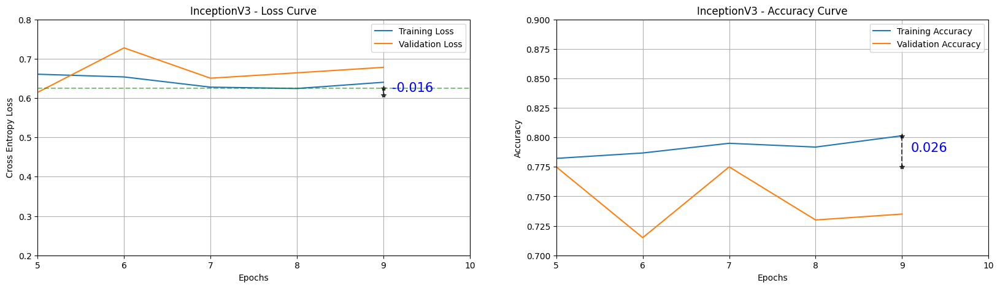

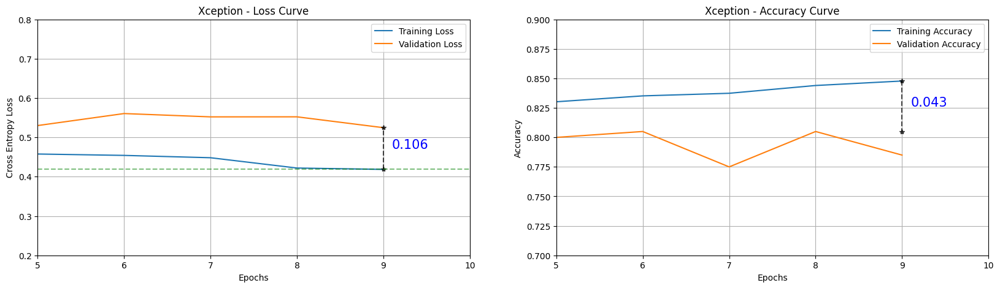

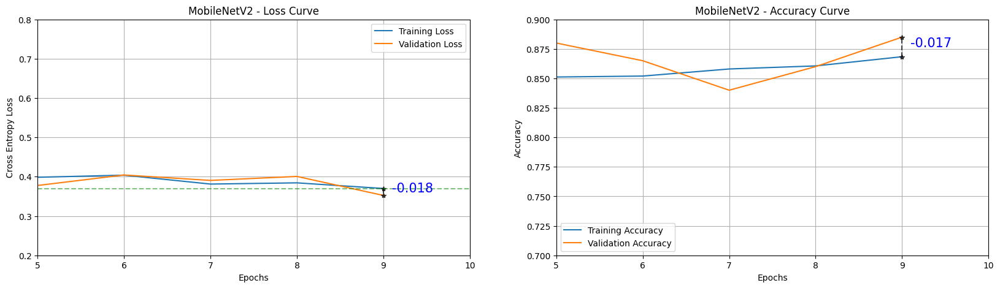

In [ ]:
# Loop over the model training curves
for name, history in HISTORIES.items():

    # Create a new figure for each backbone
    plt.figure(figsize=(20,5))

    # Plot the loss curve in the first subplot
    plt.subplot(1, 2, 1)
    plt.title(f"{name} - Loss Curve")
    plt.plot(history['loss'], label="Training Loss")
    plt.plot(history['val_loss'], label="Validation Loss")

    # Plot a vertical line at epoch 9 and annotate the difference between the validation loss and the training loss
    plt.plot([9, 9],[min(history['loss']), min(history['val_loss'])], linestyle='--', marker="*", color='k', alpha=0.7)
    plt.text(x=9.1, y=np.mean([min(history['loss']), min(history['val_loss'])]), s=str(np.round(min(history['val_loss']) - min(history['loss']),3)), fontsize=15, color='b')

    # Plot a horizontal line at epoch 9 and annotate the values for the validation loss and training loss.
    plt.axhline(min(history['loss']), color='g', linestyle="--", alpha=0.5)

    # Set the x- and y-labels, and the x- and y-limits
    plt.xlabel("Epochs")
    plt.ylabel("Cross Entropy Loss")
    plt.ylim([0.2, 0.8])
    plt.xlim([5, 10])

    # Show the legend and grid
    plt.legend()
    plt.grid()

    # Plot the accuracy curve in the second subplot
    plt.subplot(1, 2, 2)
    plt.title(f"{name} - Accuracy Curve")
    plt.plot(history['accuracy'], label="Training Accuracy")
    plt.plot(history['val_accuracy'], label="Validation Accuracy")

    # Plot a vertical line at epoch 9 and annotate the difference between the validation accuracy and the training accuracy
    plt.plot([9, 9],[max(history['accuracy']), max(history['val_accuracy'])], linestyle='--', marker="*", color='k', alpha=0.7)
    plt.text(x=9.1, y=np.mean([max(history['accuracy']), max(history['val_accuracy'])]), s=str(np.round(max(history['accuracy']) - max(history['val_accuracy']),3)), fontsize=15, color='b')

    # Set the x- and y-labels, and the x- and y-limits
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.ylim([0.7,0.9])
    plt.xlim([5, 10])

    # Show the legend and grid
    plt.legend()
    plt.grid()

    # Show the plot
    plt.show()

**Training and Evaluating a MobileNet Backbone Model**

In [ ]:
# Mobilenet Backbone
print("Loading MobileNet Backbone: ")
mobilenet = MobileNetV2(input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3), weights='imagenet', include_top=False)

# Freeze the model weights
mobilenet.trainable = False

# The Mobilenet Model baseline
mobilenet = Sequential([
    mobilenet,
    GlobalAveragePooling2D(),
    Dropout(0.5),
    Dense(n_classes, activation='softmax')
])

# Compile the Baseline
mobilenet.compile(
    loss=LOSS,
    optimizer=Adam(learning_rate=LEARNING_RATE),
    metrics=METRICS
)

# Train the Xception Baseline Model
print("\nTraining Baseline Model: ")
mobilenet.fit(
    X_train, y_train,
    validation_data=(X_valid, y_valid),
    epochs=50,
    callbacks=[
        EarlyStopping(patience=3, restore_best_weights=True),
        ModelCheckpoint("MobileNetV2Baseline.h5", save_best_only=True)
    ],
    batch_size=BATCH_SIZE
)

# Testing Evaluation
mobilenet_test_loss, mobilenet_test_acc = mobilenet.evaluate(X_test, y_test)
print(f"\nMobileNet Baseline Testing Loss     : {mobilenet_test_loss}.")
print(f"MobileNet Baseline Testing Accuracy : {mobilenet_test_acc}.")

Loading MobileNet Backbone: 

Training Baseline Model: 
Epoch 1/50
157/157 [==============================] - 9s 37ms/step - loss: 1.0254 - accuracy: 0.6274 - val_loss: 0.5690 - val_accuracy: 0.7950
Epoch 2/50
157/157 [==============================] - 5s 34ms/step - loss: 0.5813 - accuracy: 0.7914 - val_loss: 0.4787 - val_accuracy: 0.8200
Epoch 3/50
157/157 [==============================] - 5s 31ms/step - loss: 0.5072 - accuracy: 0.8182 - val_loss: 0.4606 - val_accuracy: 0.8250
Epoch 4/50
157/157 [==============================] - 5s 30ms/step - loss: 0.4476 - accuracy: 0.8424 - val_loss: 0.4251 - val_accuracy: 0.8500
Epoch 5/50
157/157 [==============================] - 5s 31ms/step - loss: 0.4338 - accuracy: 0.8424 - val_loss: 0.3974 - val_accuracy: 0.8650
Epoch 6/50
157/157 [==============================] - 5s 29ms/step - loss: 0.3985 - accuracy: 0.8568 - val_loss: 0.3934 - val_accuracy: 0.8650
Epoch 7/50
157/157 [==============================] - 4s 28ms/step - loss: 0.3979 - ac

**Building and Training a MobileNetV2 Model with Hyperparameter
Tuning**

In [ ]:
def build_model(hp):

    # Define all hyperparms
    mobilenet = MobileNetV2(input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3), weights='imagenet', include_top=False)
    mobilenet.trainable = False
    n_layers = hp.Choice('n_layers', [2, 4])
    dropout_rate = hp.Choice('rate', [0.4, 0.7])
    n_units = hp.Choice('units', [256, 512])
    learning_rate = hp.Choice('lr', [LEARNING_RATE, LEARNING_RATE * 0.1, LEARNING_RATE*0.01])

    # Mode architecture
    model = Sequential([
        mobilenet,
        GlobalAveragePooling2D(),
    ])

    # Add hidden/top layers
    for _ in range(n_layers):
        model.add(Dense(n_units, activation='relu', kernel_initializer='he_normal'))

    # Add Dropout Layer
    model.add(Dropout(dropout_rate))

    # Output Layer
    model.add(Dense(n_classes, activation='softmax'))

    # Compile the model
    model.compile(
        loss=LOSS,
        optimizer = Adam(learning_rate),
        metrics = METRICS
    )

    # Return model
    return model

In [ ]:
# Initialize Random Searcher
random_searcher = kt.RandomSearch(
    hypermodel=build_model,
    objective='val_loss',
    max_trials=5,
    seed=42,
    project_name="MobileNetSearch",
    loss=LOSS)

# Start Searching
search = random_searcher.search(
    X_train, y_train,
    validation_data=(X_valid, y_valid),
    epochs = 10,
    batch_size = BATCH_SIZE
)

Trial 9 Complete [00h 17m 35s]
val_loss: 0.363847553730011

Best val_loss So Far: 0.363847553730011
Total elapsed time: 02h 41m 01s

Search: Running Trial #10

Value             |Best Value So Far |Hyperparameter
2                 |4                 |n_layers
0.4               |0.7               |rate
256               |256               |units
0.0001            |0.001             |lr

Epoch 1/10
149/157 [===========================>..] - ETA: 4s - loss: 1.1619

In [ ]:
# Best Hyper params
best_hps = random_searcher.get_best_hyperparameters()[0]
print(f"Best Hyper Params founded: {best_hps.values}\n")

# Build the best model
mobile_net_model = build_model(best_hps)
mobile_net_model.summary()

# Compile the model
print("\nTraining Best Model Architecture : ")
mobile_net_model_history = mobile_net_model.fit(
    X_train, y_train,
    validation_data=(X_valid, y_valid),
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    callbacks=[
        EarlyStopping(patience=5, restore_best_weights=True),
        ModelCheckpoint('BestMobileNet.h5', save_best_only=True)
    ]
)

Best Hyper Params founded: {'n_layers': 4, 'rate': 0.4, 'units': 256, 'lr': 0.001}

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 mobilenetv2_1.00_160 (Func  (None, 5, 5, 1280)        2257984   
 tional)                                                         
                                                                 
 global_average_pooling2d_1  (None, 1280)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_3 (Dense)             (None, 256)               327936    
                                                                 
 dense_4 (Dense)             (None, 256)               65792     
                                                                 
 dense_5 (Dense)             (None, 256)               65792     
                                    

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


157/157 [==============================] - 10s 39ms/step - loss: 0.6927 - accuracy: 0.7444 - val_loss: 0.4139 - val_accuracy: 0.8350
Epoch 2/50
157/157 [==============================] - 5s 31ms/step - loss: 0.3575 - accuracy: 0.8804 - val_loss: 0.4199 - val_accuracy: 0.8550
Epoch 3/50
157/157 [==============================] - 5s 31ms/step - loss: 0.2555 - accuracy: 0.9136 - val_loss: 0.3528 - val_accuracy: 0.8700
Epoch 4/50
157/157 [==============================] - 5s 29ms/step - loss: 0.1647 - accuracy: 0.9484 - val_loss: 0.5506 - val_accuracy: 0.8450
Epoch 5/50
157/157 [==============================] - 5s 30ms/step - loss: 0.1293 - accuracy: 0.9558 - val_loss: 0.4508 - val_accuracy: 0.8850
Epoch 6/50
157/157 [==============================] - 5s 29ms/step - loss: 0.0887 - accuracy: 0.9714 - val_loss: 0.7435 - val_accuracy: 0.8150
Epoch 7/50
157/157 [==============================] - 5s 30ms/step - loss: 0.0754 - accuracy: 0.9742 - val_loss: 0.6279 - val_accuracy: 0.8550
Epoch 8/5

# Model Evaluation

**Evaluating the Trained MobileNetV2 Model**

In [ ]:
test_loss, test_acc = mobile_net_model.evaluate(X_test, y_test)
print("Training Loss    : {:.4} | Baseline : {:.4}".format(test_loss, mobilenet_test_loss))
print("Training Accuracy: {:.4}% | Baseline : {:.4}%".format(test_acc*100, mobilenet_test_acc*100))

4/4 [==============================] - 0s 28ms/step - loss: 0.3205 - accuracy: 0.8700
Training Loss    : 0.3205 | Baseline : 0.3711
Training Accuracy: 87.0% | Baseline : 86.0%


**Comparing Predictions and Performance Metrics**

In [ ]:
# Make predictions
baseline_pred = np.argmax(mobilenet.predict(X_test, verbose=0), axis=-1)
best_pred = np.argmax(mobile_net_model.predict(X_test, verbose=0), axis=-1)

# Evaluate prediction : Precision
baseline_pre = precision_score(y_test, baseline_pred, average='macro')
best_pre = precision_score(y_test, best_pred, average='macro')

# Evaluate prediction : Recall
baseline_recall = recall_score(y_test, baseline_pred, average='macro')
best_recall = recall_score(y_test, best_pred, average='macro')

# Evaluate prediction : F1 Score
baseline_f1 = f1_score(y_test, baseline_pred, average='macro')
best_f1 = f1_score(y_test, best_pred, average='macro')

print("{:20} | {:20}".format("Baseline Performance", "Best Performance\n"))
print("{:10} : {:.5}  | {:.5}".format("Precision", baseline_pre, best_pre))
print("{:10} : {:.5}    | {:.5}".format("Recall", baseline_recall, best_recall))
print("{:10} : {:.5} | {:.5}".format("F1 Score", baseline_f1, best_f1))

Baseline Performance | Best Performance
   
Precision  : 0.87688  | 0.87435
Recall     : 0.86    | 0.87
F1 Score   : 0.86285 | 0.86994


In [ ]:
print(classification_report(y_test, baseline_pred))

              precision    recall  f1-score   support

           0       0.71      0.85      0.77        20
           1       0.83      0.95      0.88        20
           2       1.00      0.80      0.89        20
           3       0.85      0.85      0.85        20
           4       1.00      0.85      0.92        20

    accuracy                           0.86       100
   macro avg       0.88      0.86      0.86       100
weighted avg       0.88      0.86      0.86       100



In [ ]:
print(classification_report(y_test, best_pred))

              precision    recall  f1-score   support

           0       0.80      0.80      0.80        20
           1       0.83      0.95      0.88        20
           2       0.95      0.90      0.92        20
           3       0.86      0.90      0.88        20
           4       0.94      0.80      0.86        20

    accuracy                           0.87       100
   macro avg       0.87      0.87      0.87       100
weighted avg       0.87      0.87      0.87       100



<ipython-input-27-8db3adcc0fb3>:29: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  label = class_names[int(labels[index])]


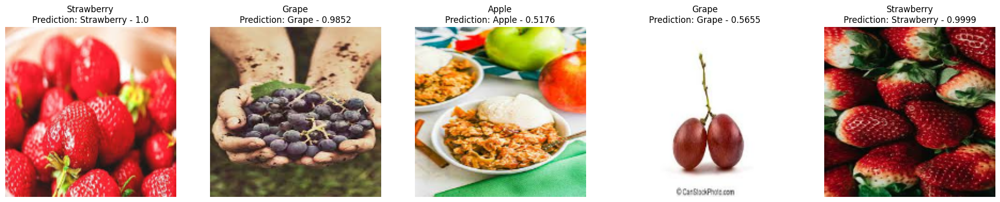

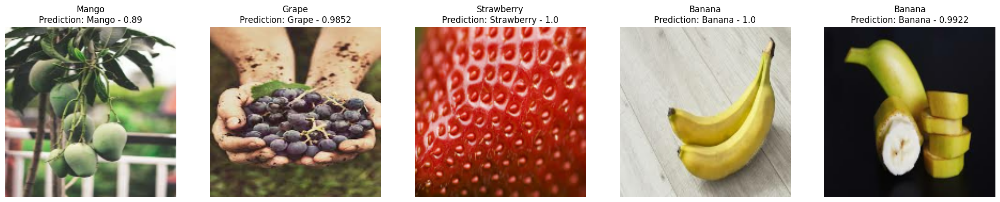

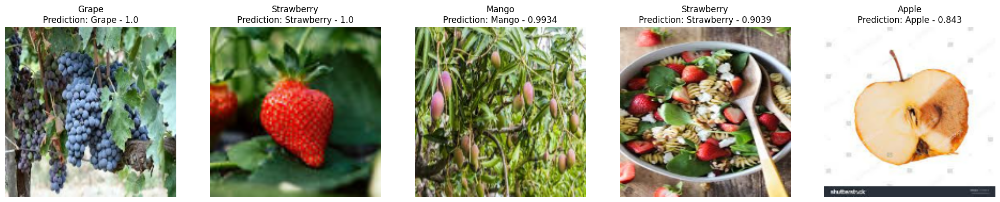

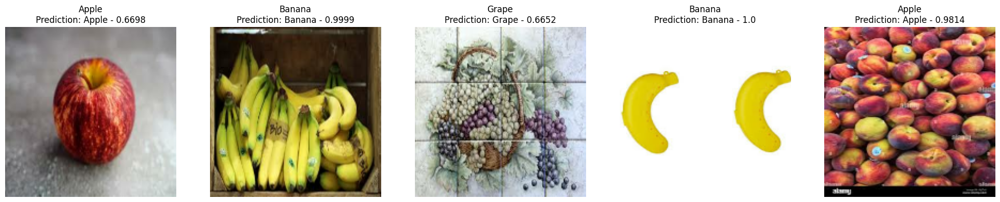

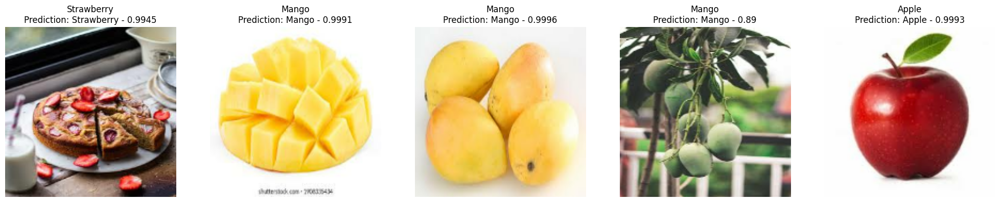

...

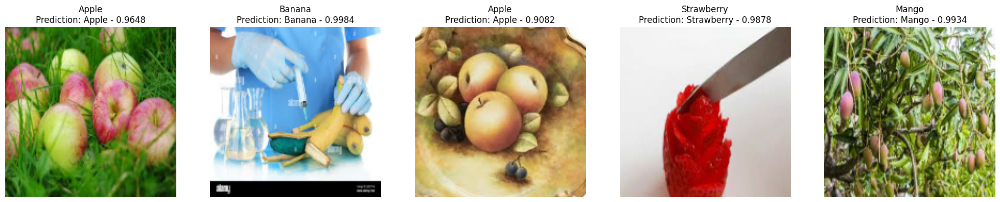

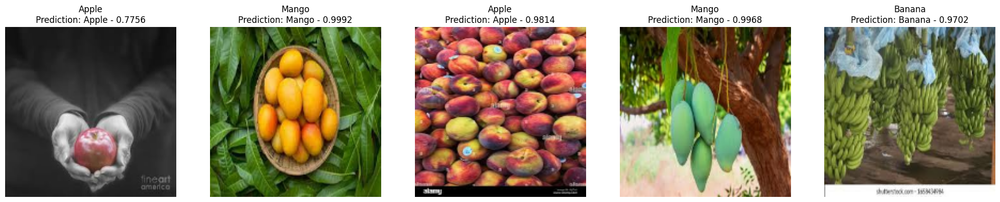

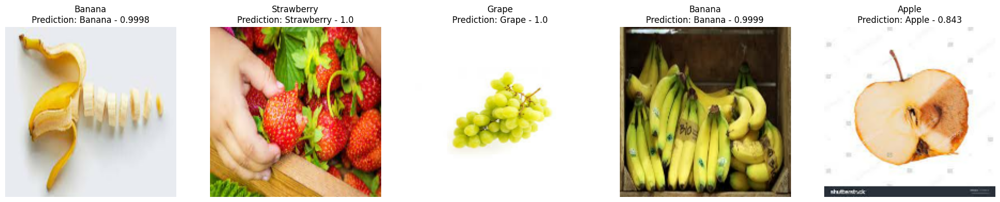

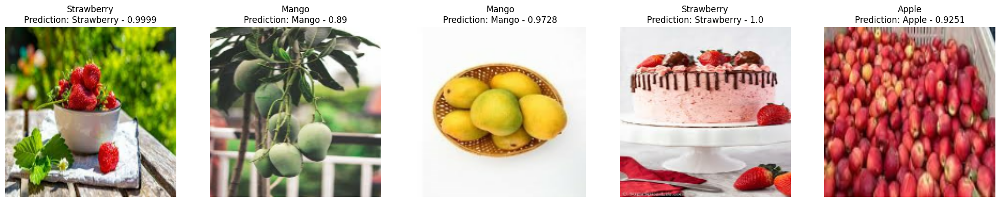

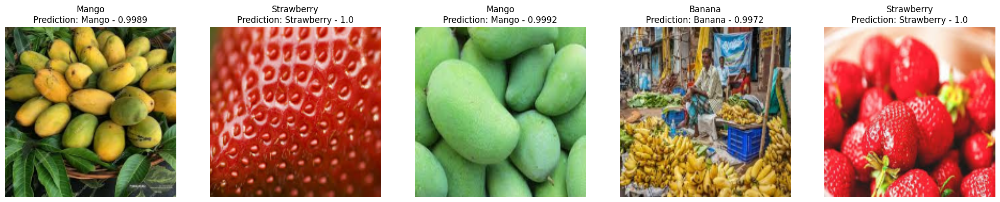

In [ ]:
show_images(images=X_test, labels=y_test, model=mobile_net_model, n_rows=20)